<a href="https://colab.research.google.com/github/JohnR0s/ClimateChangeOnReddit/blob/main/Transformations.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Doing Transformations

## Settings

Instalamos la librería dataprep

In [ ]:
!pip install -q 'dataprep'

In [ ]:
!pip install dirty-cat -q

In [ ]:
!pip install pycaret -q

##Librerias

Importamos las librerías necesarias para el proyecto

In [ ]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder

from dirty_cat import SimilarityEncoder

from dataprep.eda import create_report # EDA report

from pycaret.classification import *

##Datos

#### Carga

Creamos la conexión con Google Drive y cargamos el dataFrame obtenido previamente  

In [ ]:
from google.colab import drive
drive.mount('drive')

Realizamos la carga del DataFrame

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Data/clean_data.csv')

In [ ]:
df.info()

##Null Data

In [ ]:
df.isna().sum()

In [ ]:
del(df['title'])

In [ ]:
df = df.dropna()

##Transformaciones

In [ ]:
df.info()

###Label Encoder

Utilizamos Label Encoder para llevar la columna Type a valores binarios

In [ ]:
le = LabelEncoder()
le.fit(df['type'])
df['type'] = le.transform(df['type'])

###Standardization

Llevaremos la columna value a un formato -1, 0 y +1 según su valor

In [ ]:
df['Value'] = df['Value'].map(lambda x: -1 if x <0 else 0 if x == 0 else 1)

###Similarity Encoder

Creamos una copia del dataset antes de implementar el encoder

In [ ]:
df_similarity = df.copy()

Creamos una variable y ajustamos el encoder a la columna selftext

In [ ]:
similarity_encoder = SimilarityEncoder()

Obtenemos un array con los datos transformados

In [ ]:
transformed_values = similarity_encoder.fit_transform(df_similarity['selftext'].values.reshape(-1,1))

In [ ]:
len(transformed_values)

228065

Creamos un arreglo de nombres para agregarlo al DataFrame

In [ ]:
column_names = [str(x) for x in range(transformed_values.shape[1])]

Convertimos el arrelgo de valores transformados en un DataFrame utilizando el arreglo anterior para nombrar las columnas

In [ ]:
df_aux = pd.DataFrame(transformed_values, columns = column_names)

In [ ]:
df_similarity.shape, df_aux.shape

((228065, 8), (228065, 59))

In [ ]:
df_similarity.isna().sum()

type         0
selftext     0
sentiment    0
score        0
Year         0
Area         0
Months       0
Value        0
dtype: int64

Concatenamos ambos dataframes

In [ ]:
df_similarity = pd.concat([df_similarity, df_aux], axis=1)

In [ ]:
df_similarity.shape

(259025, 67)

In [ ]:
df_similarity.isna().sum()

type         30960
selftext     30960
sentiment    30960
score        30960
Year         30960
             ...  
54           30960
55           30960
56           30960
57           30960
58           30960
Length: 67, dtype: int64

In [ ]:
df_similarity.dropna(inplace=True)

###OneHot

In [ ]:
df_onehot = df.copy()

In [ ]:
encoder = OneHotEncoder(sparse=False)

In [ ]:
encoded = encoder.fit_transform(df[['selftext']])

In [ ]:
df_encoded = pd.DataFrame(encoded, columns=encoder.get_feature_names_out(['selftext']))
df_onehot= pd.concat([df_onehot, df_encoded], axis=1)

In [ ]:
df_onehot.dropna(inplace=True)

## EDA (Reporte)

Obtenemos un repórte con las características de cada conjunto transformado

/usr/local/lib/python3.10/dist-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/usr/local/lib/python3.10/dist-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/usr/local/lib/python3.10/dist-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/usr/local/lib/python3.10/dist-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is depreca

My Report
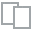
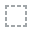
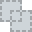
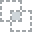
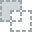
...
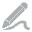
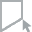
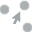
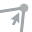
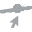

In [ ]:
report = create_report(df_similarity, title='My Report')
report

/usr/local/lib/python3.10/dist-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/usr/local/lib/python3.10/dist-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/usr/local/lib/python3.10/dist-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/usr/local/lib/python3.10/dist-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is depreca

My Report
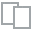
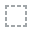
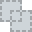
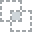
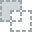
...
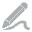
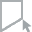
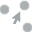
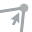
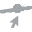

In [ ]:
report = create_report(df_onehot, title='My Report')
report

##Prueba del Modelado

###Binary Classification

Inicializamos la clase

In [ ]:
exp = ClassificationExperiment()

#### Experimento 1 (S)

In [ ]:
train_data, test_data = train_test_split(df_similarity, test_size=0.2, random_state=42)

In [ ]:
train_data.shape

(157684, 67)

Evaluamos similarity encoder con binary classification.

In [ ]:
clf = setup(data=train_data,
            target="sentiment",
            session_id=42, #random_state
            n_jobs=-1
            # silent=True
            )

clf

In [ ]:
best_model = compare_models(fold=2)
best_model

Processing:   0%|          | 0/65 [00:00<?, ?it/s]

[]

####Experimento 2 (OH)

In [ ]:
train_data, test_data = train_test_split(df_onehot, test_size=0.2, random_state=42)

Evaluamos one hot encoder con binary classification.

In [ ]:
clf = setup(data=train_data,
            target="sentiment",
            session_id=42, #random_state
            # silent=True
            )

clf

In [ ]:
best_model = compare_models()
best_model

Processing:   0%|          | 0/65 [00:00<?, ?it/s]

[]

###Multiclass Classification

####Experimento 1 (S)

In [ ]:
train_data, test_data = train_test_split(df_similarity, test_size=0.2, random_state=42)

Evaluamos similarity encoder con multiclass classification.

In [ ]:
clf = setup(data=train_data,
            target="sentiment",
            session_id=42, #random_state
            # silent=True
            )

clf

In [ ]:
best_model = compare_models()
best_model

Processing:   0%|          | 0/65 [00:00<?, ?it/s]

[]

####Experimento 2 (OH)

In [ ]:
train_data, test_data = train_test_split(df_onehot, test_size=0.2, random_state=42)


Evaluamos one hot encoder con multiclass classification.

In [ ]:
clf = setup(data=train_data,
            target="sentiment",
            session_id=42, #random_state
            # silent=True
            )

clf

In [ ]:
best_model = compare_models()
best_model

Processing:   0%|          | 0/65 [00:00<?, ?it/s]

[]

##Conclusiones

En este proyecto de desarrolló y ejemplificó la idea de la importancia que tiene realizar un preprocesamiento adecuado al conjunto de datos trabajado. Esta etapa del ciclo de análisis tiene una importancia fundamental para la obtención de buenos resultados. El contar con datos de calidad será en gran medida lo que determine qué tan buenos resultados generará el modelo.

Es importante resaltar así mismo la utilidad y beneficio de apoyarse de herramientas que están a nuestro alcance y aligeran la carga de trabajo. Esto sin perder de vista que es uno quien debe asegurarse de corroborar y analizar los resultados.

# DATA SETS

[Reddit](https://www.kaggle.com/datasets/pavellexyr/the-reddit-climate-change-dataset) | [FAO temperature](https://www.kaggle.com/datasets/sevgisarac/temperature-change)

### Diccionario de datos

01. **type**: Tipo de fuente de dato (comentario/post).
02. **selftext**: Cuerpo del texto.
03. **sentiment**: Sentimiento del comentario.
04. **score**: Puntaje del comentario
05. **title**: Titulo del post.
06. **Year**: Año en que se publicó.
07. **Area**: Nombre del país.
08. **Months**: Mes
09. **Value**: Cambio en la temperatura.
10. **0-58**: Similarity/One Hot values